# Bike counts on Seattle's Fremont Bridge

Seattle'ın Fremont Köprüsü'ndeki bisiklet sayımlarına bir göz atalım. Bu veri, 2012 sonlarında kurulan ve köprünün doğu ve batı kaldırımlarında endüktif sensörler bulunan otomatik bir bisiklet sayacından geliyor

<img src="https://images.seattletimes.com/wp-content/uploads/2018/02/202796_7-16LO3055_182055.jpg?d=780x503">

<a href="https://raw.githubusercontent.com/amankharwal/Fremont-Bridge-Bicycle-Counts/master/fremont-bridge.csv">Dataya Buradan Erişebilersiniz</a>

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px

### Prophet

In [2]:
df=pd.read_csv("fremont-bridge.csv")

In [3]:
df

,Date,West,East
0,10/3/2012 0:00,4.0,9.0
1,10/3/2012 1:00,4.0,6.0
2,10/3/2012 2:00,1.0,1.0
3,10/3/2012 3:00,2.0,3.0
4,10/3/2012 4:00,6.0,1.0
...,...,...,...
45979,12/31/2017 19:00,9.0,12.0
45980,12/31/2017 20:00,6.0,8.0
45981,12/31/2017 21:00,3.0,10.0
45982,12/31/2017 22:00,7.0,6.0


In [4]:
df["toplam"]=df["West"]+df["East"]

In [5]:
df.head()

,Date,West,East,toplam
0,10/3/2012 0:00,4.0,9.0,13.0
1,10/3/2012 1:00,4.0,6.0,10.0
2,10/3/2012 2:00,1.0,1.0,2.0
3,10/3/2012 3:00,2.0,3.0,5.0
4,10/3/2012 4:00,6.0,1.0,7.0


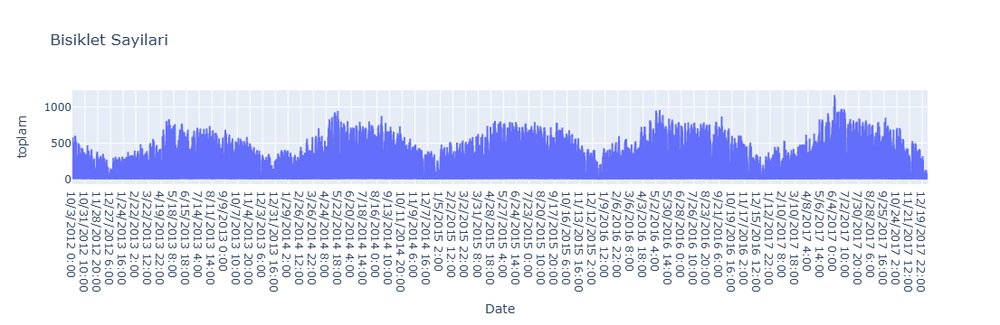

In [6]:
px.line(df,x="Date",y="toplam",title="Bisiklet Sayilari")

In [7]:
df["Date"]=pd.to_datetime(df["Date"])

In [8]:
df

,Date,West,East,toplam
0,2012-10-03 00:00:00,4.0,9.0,13.0
1,2012-10-03 01:00:00,4.0,6.0,10.0
2,2012-10-03 02:00:00,1.0,1.0,2.0
3,2012-10-03 03:00:00,2.0,3.0,5.0
4,2012-10-03 04:00:00,6.0,1.0,7.0
...,...,...,...,...
45979,2017-12-31 19:00:00,9.0,12.0,21.0
45980,2017-12-31 20:00:00,6.0,8.0,14.0
45981,2017-12-31 21:00:00,3.0,10.0,13.0
45982,2017-12-31 22:00:00,7.0,6.0,13.0


In [9]:
ydf=df.groupby(df["Date"]).agg({"East":"sum" , "West":"sum", "toplam":"sum"}).reset_index()

In [10]:
ydf

,Date,East,West,toplam
0,2012-10-03 00:00:00,9.0,4.0,13.0
1,2012-10-03 01:00:00,6.0,4.0,10.0
2,2012-10-03 02:00:00,1.0,1.0,2.0
3,2012-10-03 03:00:00,3.0,2.0,5.0
4,2012-10-03 04:00:00,1.0,6.0,7.0
...,...,...,...,...
45979,2017-12-31 19:00:00,12.0,9.0,21.0
45980,2017-12-31 20:00:00,8.0,6.0,14.0
45981,2017-12-31 21:00:00,10.0,3.0,13.0
45982,2017-12-31 22:00:00,6.0,7.0,13.0


In [11]:
ydf['Date'] = ydf['Date'].dt.strftime('%d-%m-%Y')

In [12]:
ydf

,Date,East,West,toplam
0,03-10-2012,9.0,4.0,13.0
1,03-10-2012,6.0,4.0,10.0
2,03-10-2012,1.0,1.0,2.0
3,03-10-2012,3.0,2.0,5.0
4,03-10-2012,1.0,6.0,7.0
...,...,...,...,...
45979,31-12-2017,12.0,9.0,21.0
45980,31-12-2017,8.0,6.0,14.0
45981,31-12-2017,10.0,3.0,13.0
45982,31-12-2017,6.0,7.0,13.0


In [13]:
ydf.to_csv("yedek.csv")

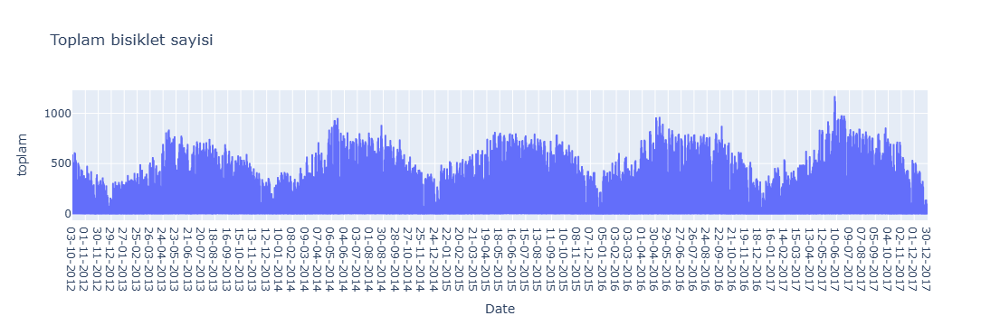

In [14]:
px.line(ydf,x="Date",y="toplam",title="Toplam bisiklet sayisi")

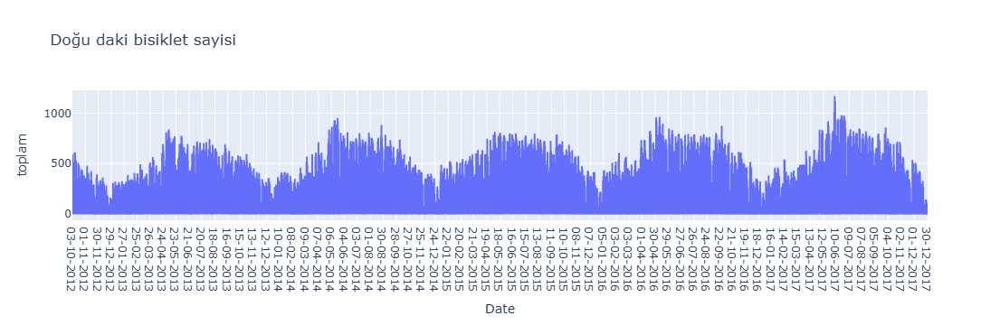

In [15]:
px.line(ydf,x="Date",y="toplam",title="Doğu daki bisiklet sayisi")

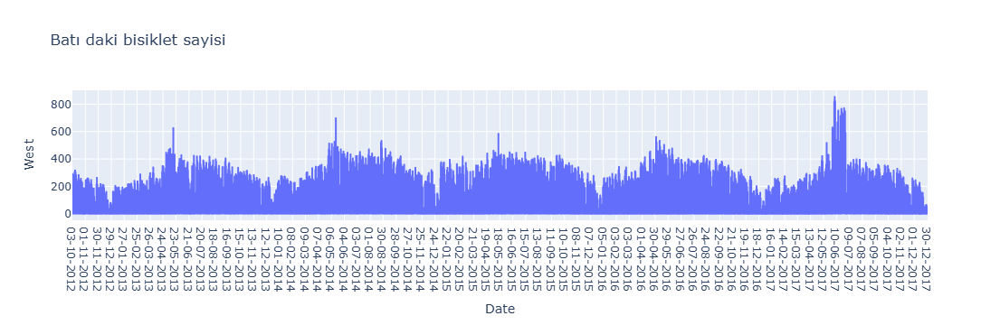

In [16]:
px.line(ydf,x="Date",y="West",title="Batı daki bisiklet sayisi")

<Axes: >

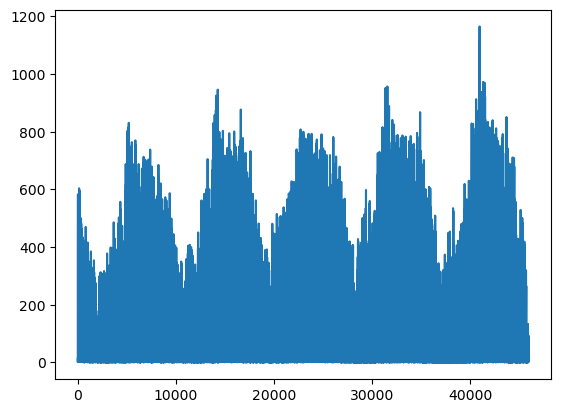

In [17]:
ydf.toplam.plot()

In [18]:
ydf["Date"]=pd.to_datetime(df["Date"])

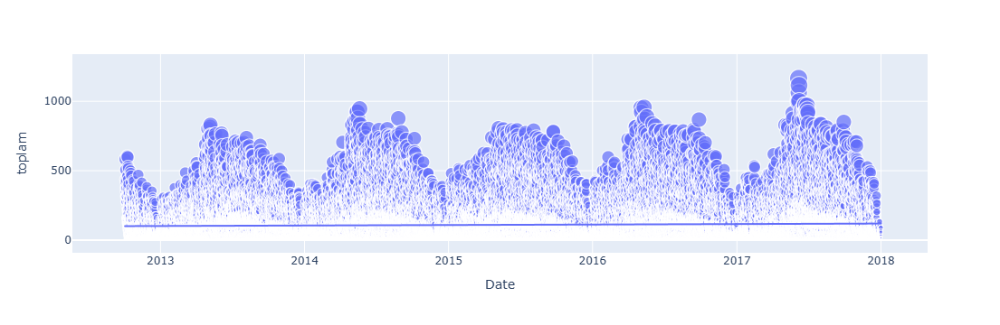

In [19]:
px.scatter(ydf,x="Date",y="toplam",size="toplam",trendline="ols")

In [20]:
ydf["day"]=df["Date"].dt.day
ydf["month"]=df["Date"].dt.month
ydf["year"]=df["Date"].dt.year

<Axes: xlabel='month', ylabel='Value'>

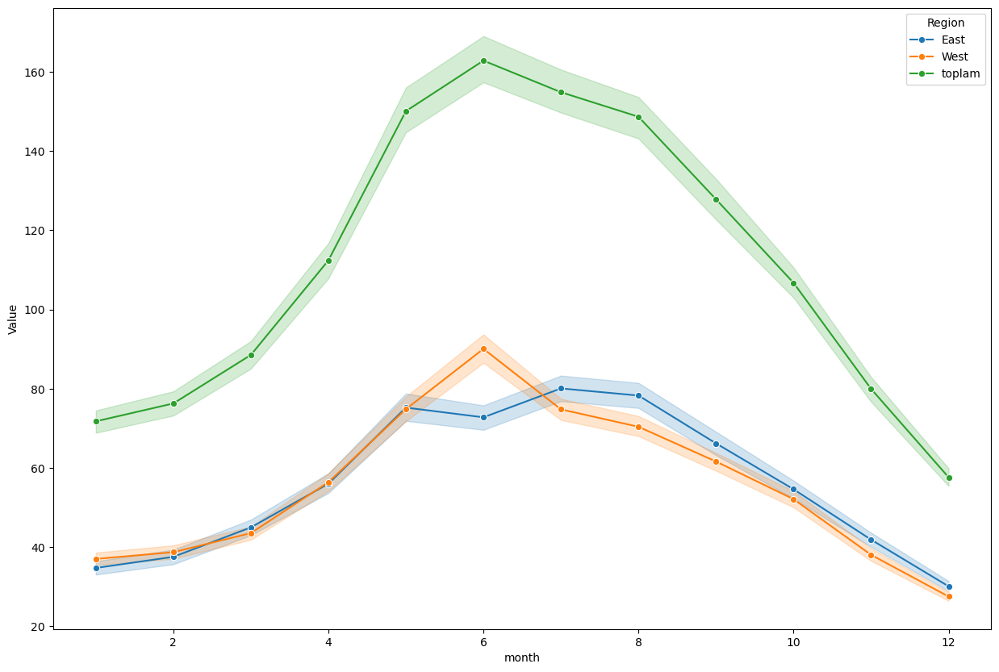

In [21]:
df_melted = ydf.melt(id_vars=['month'], value_vars=['East', 'West', 'toplam'], 
                    var_name='Region', value_name='Value')

# Grafiği oluşturma
plt.figure(figsize=(15, 10))
sns.lineplot(data=df_melted, x='month', y='Value', hue='Region', marker='o')

<Axes: xlabel='day', ylabel='Value'>

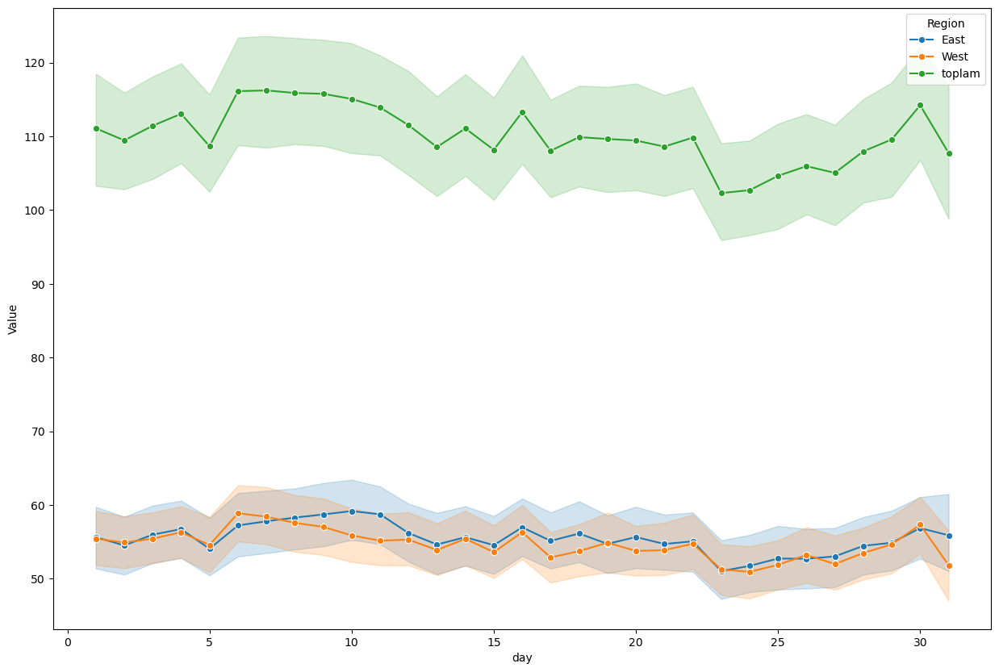

In [22]:
df_melted = ydf.melt(id_vars=['day'], value_vars=['East', 'West', 'toplam'], 
                    var_name='Region', value_name='Value')

# Grafiği oluşturma
plt.figure(figsize=(15, 10))
sns.lineplot(data=df_melted, x='day', y='Value', hue='Region', marker='o')

<Axes: xlabel='year', ylabel='Value'>

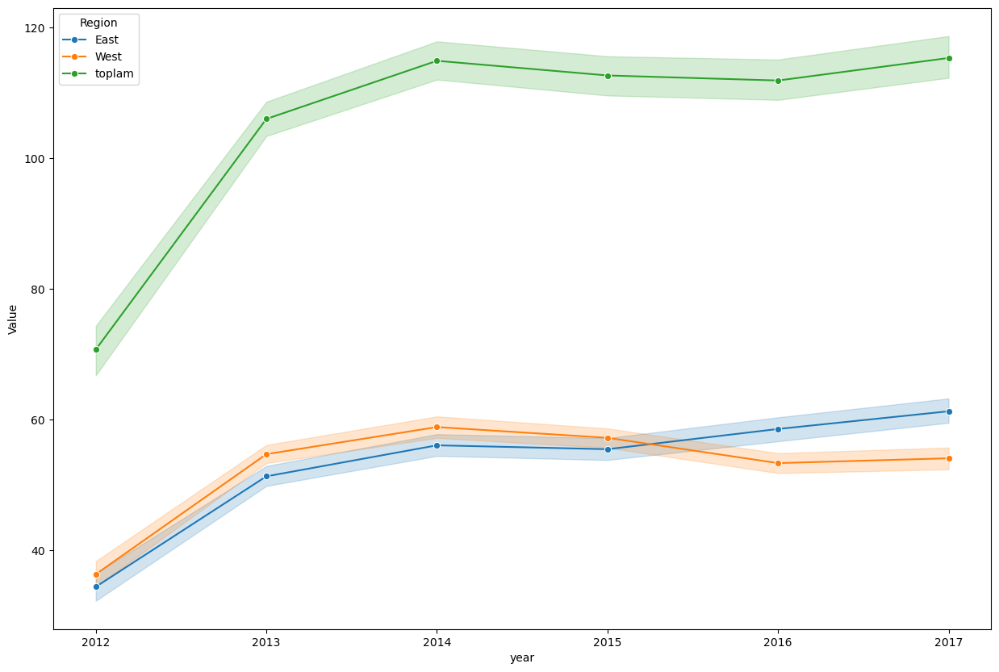

In [23]:
df_melted = ydf.melt(id_vars=['year'], value_vars=['East', 'West', 'toplam'], 
                    var_name='Region', value_name='Value')

# Grafiği oluşturma
plt.figure(figsize=(15, 10))
sns.lineplot(data=df_melted, x='year', y='Value', hue='Region', marker='o')

In [24]:
forecast_data=ydf.rename(columns={"Date":"ds","East": "y"})

In [25]:
#pip install prophet

20:07:40 - cmdstanpy - INFO - Chain [1] start processing
20:07:47 - cmdstanpy - INFO - Chain [1] done processing


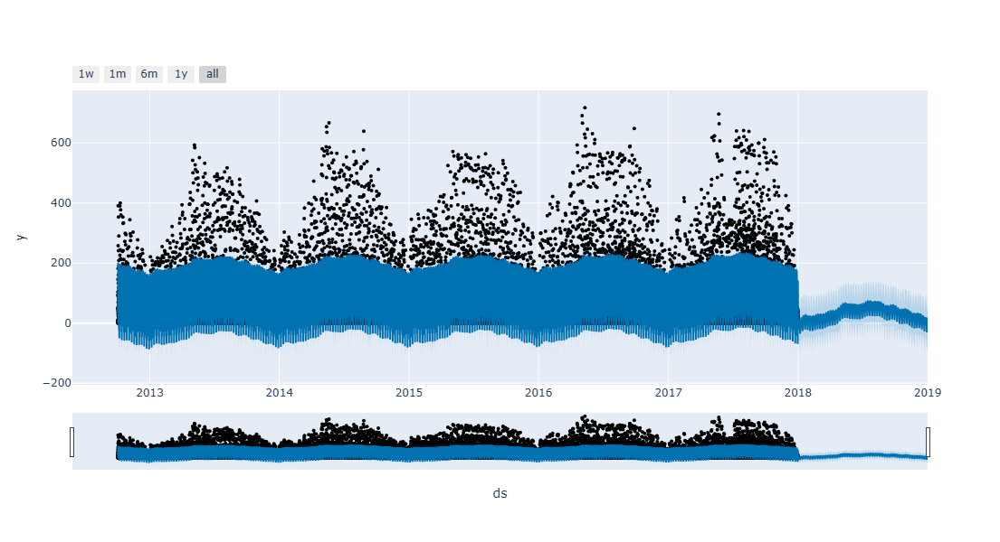

In [26]:
from prophet import Prophet
from prophet.plot import plot_plotly, plot_components_plotly
model=Prophet()
model.fit(forecast_data)
forecasts=model.make_future_dataframe(periods=365)
predictions=model.predict(forecasts)
plot_plotly(model,predictions)

### SARIMA

In [27]:
import pandas as pd
from datetime import date,timedelta
import datetime
import matplotlib.pyplot as plt
from statsmodels.tsa.seasonal import seasonal_decompose
from statsmodels.tsa.arima_model import ARIMA
import statsmodels.api as sm

In [28]:
import plotly.express as px

In [29]:
df=pd.read_csv("yedek.csv")

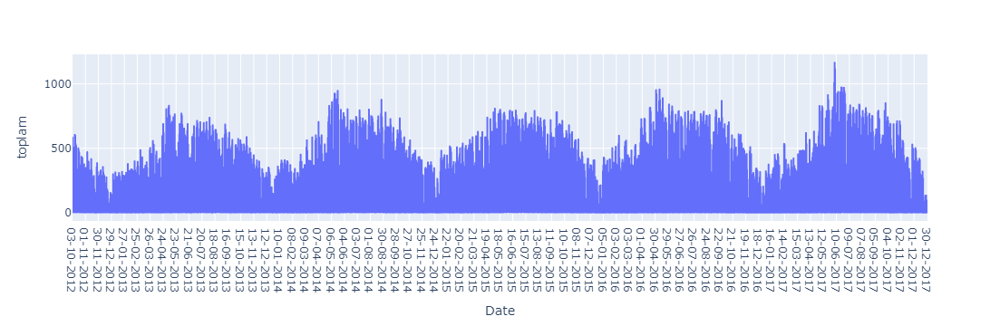

In [30]:
px.line(df,x="Date", y="toplam")

In [32]:
print(df[df["toplam"] <= 0])

       Unnamed: 0        Date  East  West  toplam
699           699  01-11-2012   0.0   0.0     0.0
1225         1225  23-11-2012   0.0   0.0     0.0
1227         1227  23-11-2012   0.0   0.0     0.0
1298         1298  26-11-2012   0.0   0.0     0.0
1443         1443  02-12-2012   0.0   0.0     0.0
...           ...         ...   ...   ...     ...
45841       45841  26-12-2017   0.0   0.0     0.0
45842       45842  26-12-2017   0.0   0.0     0.0
45843       45843  26-12-2017   0.0   0.0     0.0
45866       45866  27-12-2017   0.0   0.0     0.0
45889       45889  28-12-2017   0.0   0.0     0.0

[456 rows x 5 columns]


In [36]:
df["toplam"] = df["toplam"].replace(0, 1)  # Sıfır olanları 1 ile değiştir

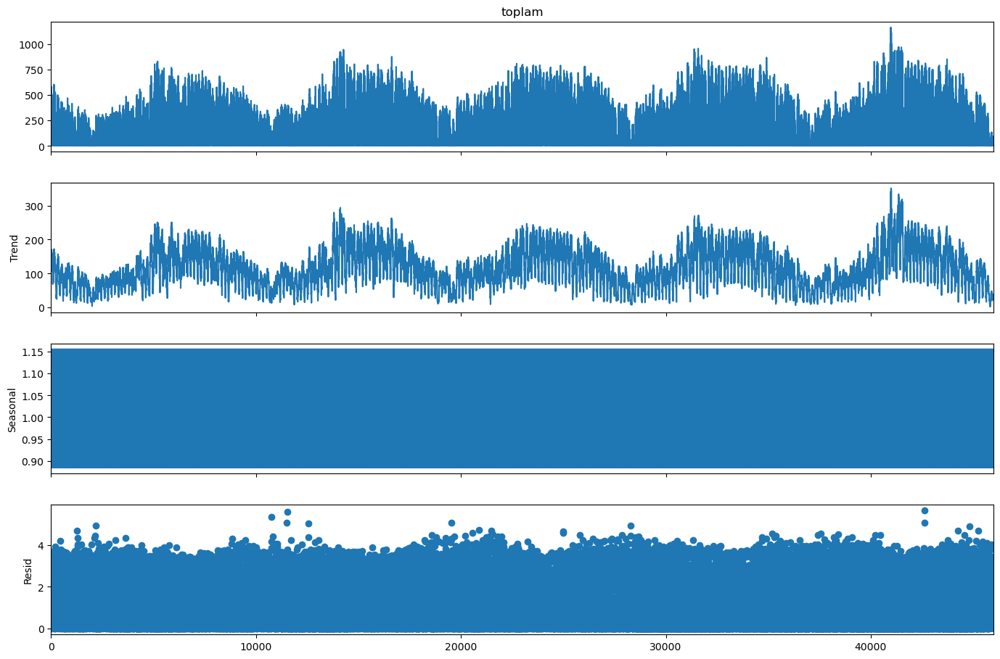

In [35]:
result=seasonal_decompose(df["toplam"],model="multiplicative",period=30)
fig=result.plot()
fig.set_size_inches(15,10)

<Axes: xlabel='Lag', ylabel='Autocorrelation'>

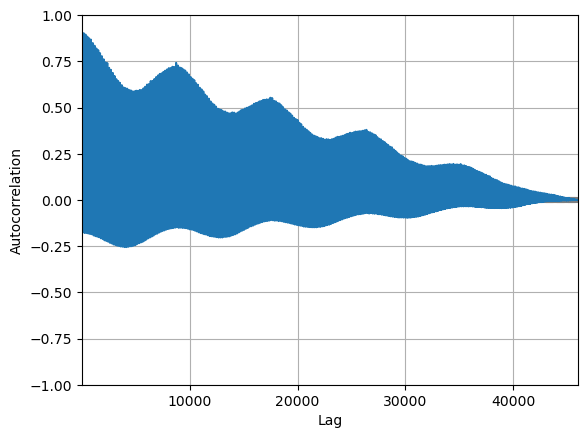

In [37]:
pd.plotting.autocorrelation_plot(df["toplam"])

In [38]:
model=sm.tsa.statespace.SARIMAX(df["toplam"])
results=model.fit()
results.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                               SARIMAX Results                                
==============================================================================
Dep. Variable:                 toplam   No. Observations:                45984
Model:               SARIMAX(1, 0, 0)   Log Likelihood             -272718.316
Date:                Tue, 01 Oct 2024   AIC                         545440.633
Time:                        20:11:05   BIC                         545458.105
Sample:                             0   HQIC                        545446.127
                              - 45984                                         
Covariance Type:                  opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.8583      0.001    629.968      0.000       0.856       0.861
sigma2      8296.2540     30.117    275.467      0.000    8237.226    8355.282
===================================================================================
Ljung-Box (L1) (Q):                5678.18   Jarque-Bera (JB):             68536.57
Prob(Q):                              0.00   Prob(JB):                         0.00
Heteroskedasticity (H):               1.58   Skew:                             1.34
Prob(H) (two-sided):                  0.00   Kurtosis:                         8.34
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
"""

In [39]:
predictions=results.predict(len(df),len(df)+7)
predictions

45984    13.733151
45985    11.787465
45986    10.117440
45987     8.684021
45988     7.453685
45989     6.397662
45990     5.491253
45991     4.713263
Name: predicted_mean, dtype: float64

<Axes: >

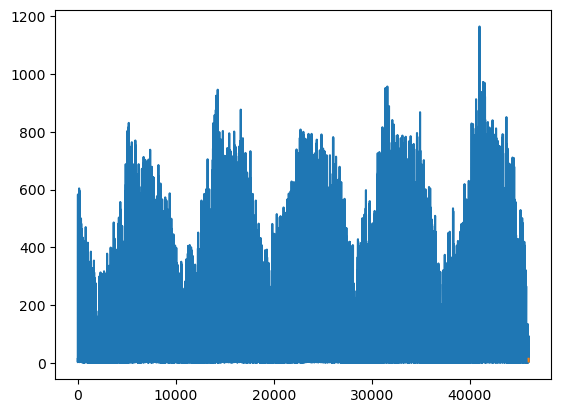

In [40]:
df["toplam"].plot()
predictions.plot()

Sonuc olarak Fremont köprürsünden geçen toplam bisikletlerin grafiklerini çizdirdik ve bir sonraki yılın sayılarını tahmin ettik.